In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages
import matplotlib.colors as colors
import matplotlib.image as mpimg
from matplotlib.font_manager import FontProperties
import glob
import json
import numpy as np

from fragmenter import utils, fragment
from openeye import oechem
from openmoltools import openeye
from rdkit.Chem import AllChem as Chem
from rdkit.Chem.Lipinski import RotatableBondSmarts
import pandas as pd
import itertools
from cclib.parser import Psi
import oenotebook as oenb
import seaborn as sbn

from pylab import rcParams
rcParams['figure.figsize'] = 12, 12
import seaborn as sbn
sbn.set_style("ticks") 
rcParams['figure.figsize'] = 12, 12
rcParams['legend.frameon'] = True

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binary incompatibility. Expected 96, got 88
  return f(*args, **kwds)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: numpy.dtype size changed, may indicate binar

In [2]:
mollist = utils.to_oemol('clinical_kinase_inhbitors_tagged.smi', title='title', verbose=False)

In [143]:
bond_orders_arrays = {}
bond_orders_energy = {}
tagged_smiles = {}
for mol in mollist:
    name = mol.GetTitle()
    print(name)
    outfiles = glob.glob('geometry_opt/{}/*output.bo.json'.format(name))
    conformations = len(outfiles)
    n_atoms = mol.GetMaxAtomIdx()
    wiberg_array = np.zeros((conformations, n_atoms, n_atoms))
    mayer_array = np.zeros((conformations, n_atoms, n_atoms))
    errored_files = 0
    for i, file in enumerate(outfiles):
        f = open(file, 'r')
        data = json.load(f)
        f.close()
        # Check for errors
        error = data['error']
        if error:
            print(error)
            errored_files +=1
            continue
        data['bond_orders'] = utils.bond_order_from_psi4_raw_output(data['raw_output'])
        data.pop('raw_output')
        tagged_smiles[name] = data['tagged_smiles']
        wiberg_array[i-errored_files] = data['bond_orders']['Wiberg_psi4']
        mayer_array[i-errored_files] = data['bond_orders']['Mayer_psi4']
        #bond_order.append(data['bond_orders'])
        bond_orders_energy[name] = {}
        bond_orders_energy[name][data['return_value']] = data['bond_orders']
    if errored_files > 0:
        #remove end of array
        wiberg_array = wiberg_array[:-errored_files]
        mayer_array = mayer_array[:-errored_files]
    bond_orders_arrays[name] = {'Wiberg': wiberg_array, 'Mayer': mayer_array}

Imatinib
Dasatinib
Nilotinib
RuntimeError('\nFatal Error: Iterations did not converge.\nError occurred in file: /scratch/psilocaluser/conda-builds/psi4_1514132855674/work/psi4/src/psi4/libpsi4util/process.cc on line: 112\nThe most recent 5 function calls were:\n\npsi::die_if_not_converged()\npsi::scf::HF::finalize_E()\npsi::scf::HF::compute_energy()\n',)
Bosutinib
Ponatinib
Gefitinib
Erlotinib
Afatinib
Lapatinib
Sorafenib
Sunitinib
Pazopanib
Vandetanib
Axitinib
Regorafenib
Crizotinib
Ceritinib
Vemurafenib
Dabrafenib
Ruxolitinib
Tofacitinib
Cabozantinib
Ibrutinib
Nintedanib
Trametinib
Idelalisib
Lenvatinib
Palbociclib
Cobimetinib
Osimertinib
Alectinib
Brigatinib
Cabozantinib
Midostaurin
Neratinib
Abemaciclib
Acalabrutinib
Ribociclib


In [ ]:
# built correlation matrix
bond_correlations = {}
for mol in mollist:
    name = mol.GetTitle()
    if name not in tagged_smiles:
        print('{} not optimized'.format(name))
        continue
    molecule, atom_map = utils.get_atom_map(tagged_smiles=tagged_smiles[name])
    for conformation in bond_orders_arrays[name]['Wiberg']:
        bonds.update(utils.bond_order_to_bond_graph(conformation, hydrogen_bond=False, molecule=molecule, 
                                                atom_map=atom_map, threshold=0.83))
    bond_correlations[]

Ponatinib not optimized


/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

Trametinib not optimized


/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

Cobimetinib not optimized


/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

Acalabrutinib not optimized


/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


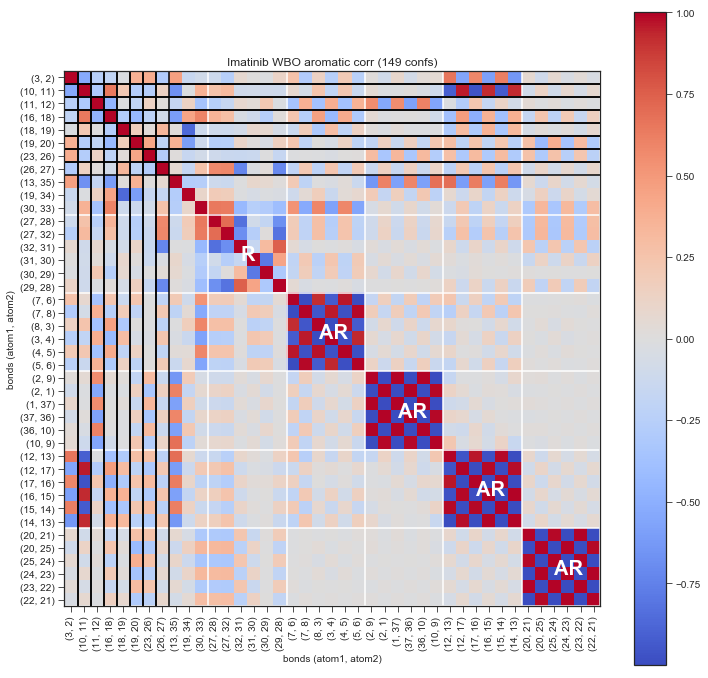

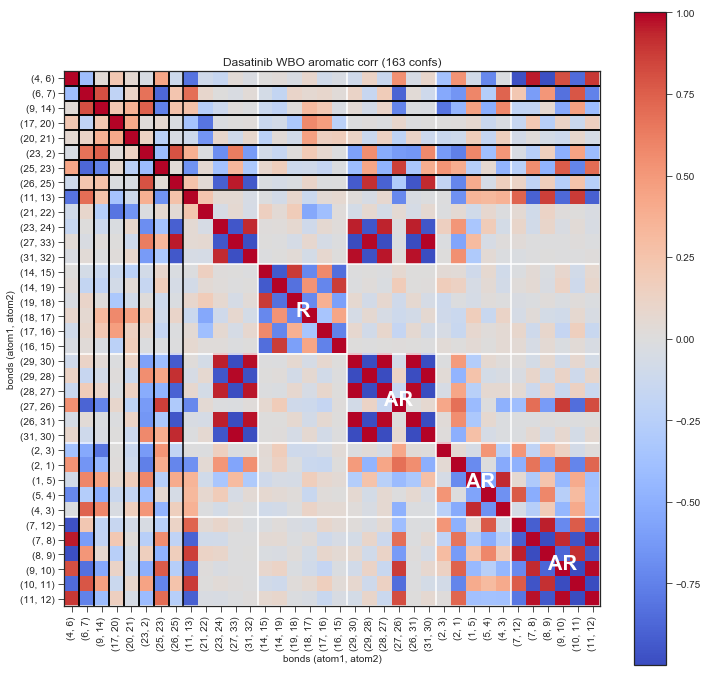

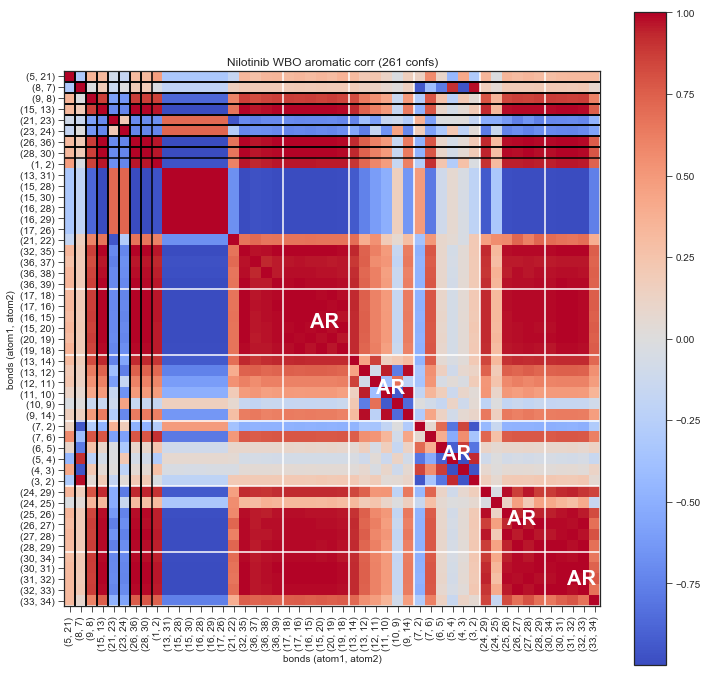

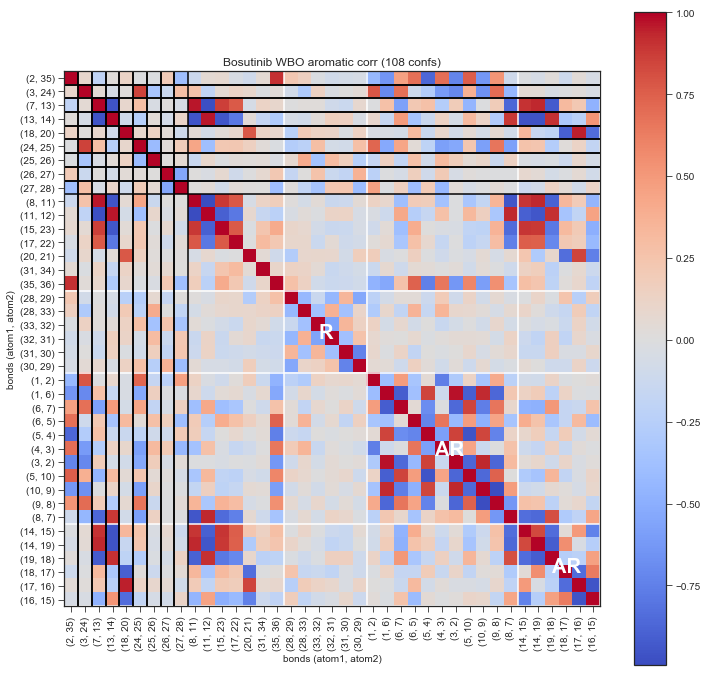

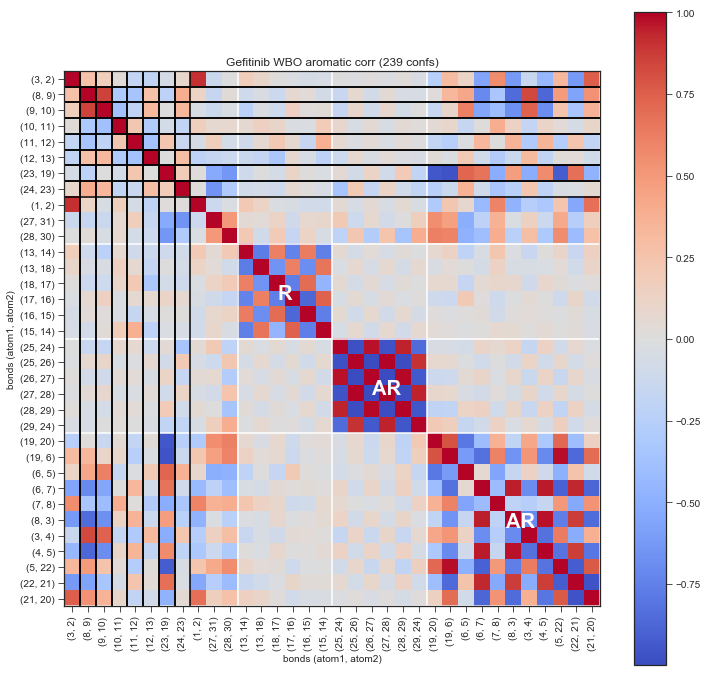

...

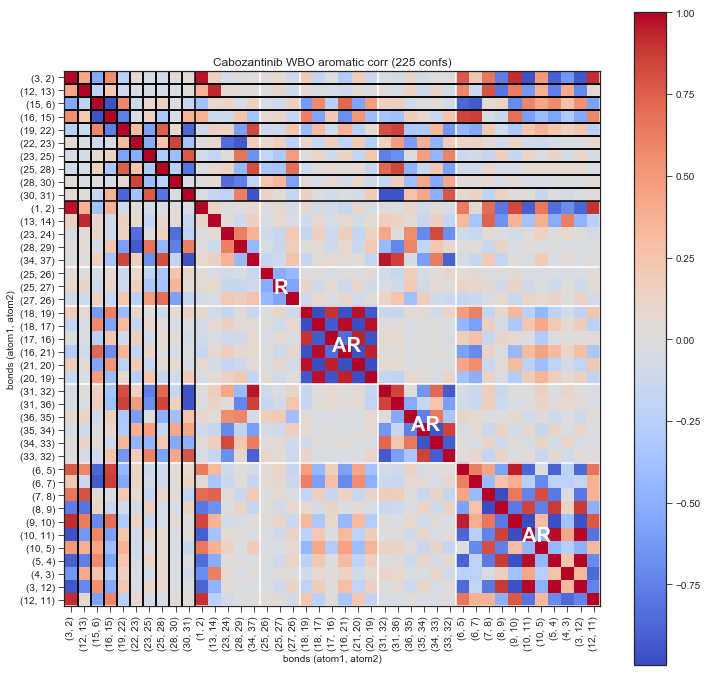

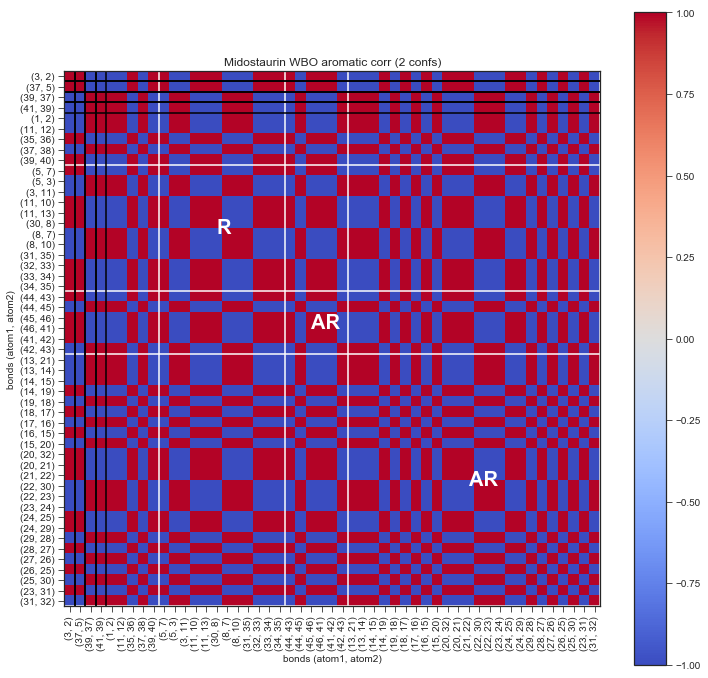

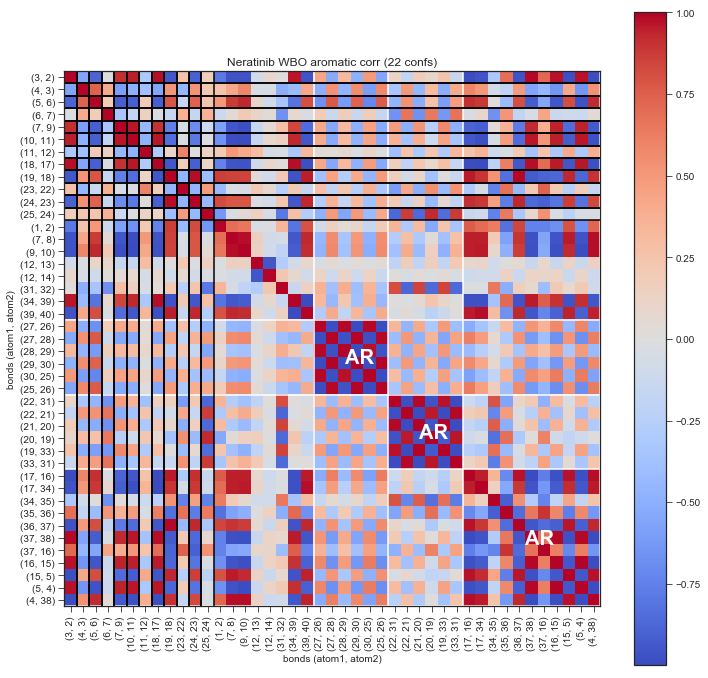

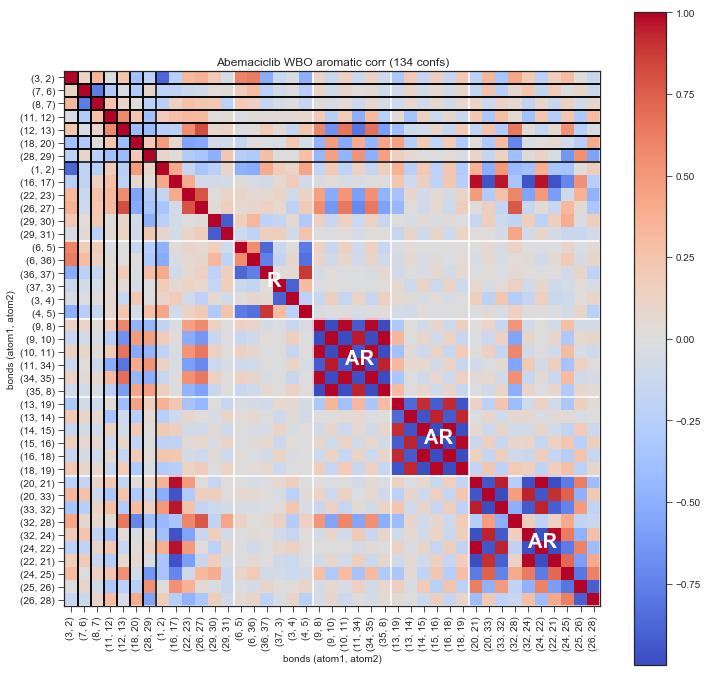

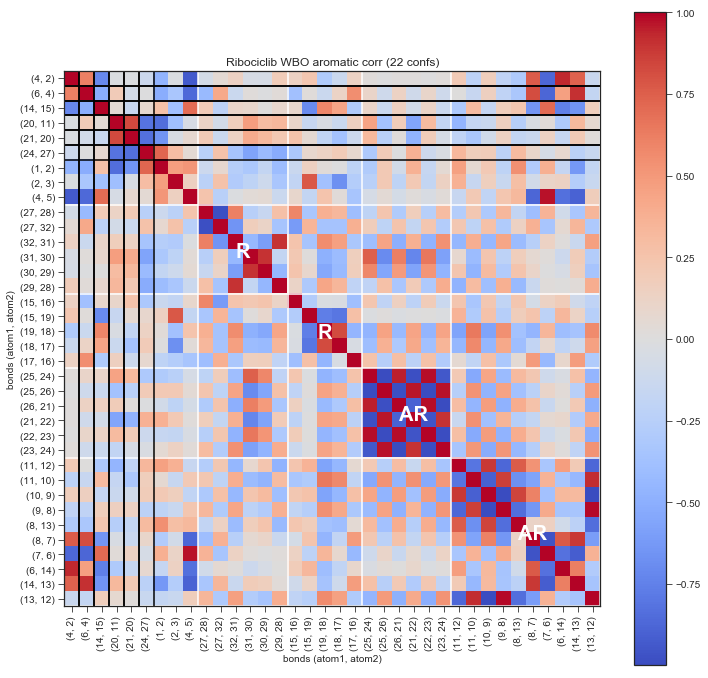

In [290]:
# Find bonds from bond orders (for all conformation is bond order is above 0.8)
# Find all possible bonds with threshold above 0.8
for mol in mollist:
    bonds = set()
    name = mol.GetTitle()
    if name not in tagged_smiles:
        print('{} not optimized'.format(name))
        continue
    molecule, atom_map = utils.get_atom_map(tagged_smiles=tagged_smiles[name])
    for conformation in bond_orders_arrays[name]['Wiberg']:
        bonds.update(utils.bond_order_to_bond_graph(conformation, hydrogen_bond=False, molecule=molecule, 
                                                atom_map=atom_map, threshold=0.83))
    bonds = list((bonds))
    bonds = sorted(bonds, key=lambda element: (element[0], element[1]))
    
    # sort bonds by ring systems
    nringsystems, parts = oechem.OEDetermineRingSystems(molecule)
    aromatic_bonds_sorted = []
    ring_bonds_sorted = []
    rot_bonds = []
    ring_sizes_aliphatic = []
    ring_sizes_aromatic = []
    for ringidx in range(1, nringsystems + 1):
        i = 0
        j = 0
        ring_type = None
        for bond in molecule.GetBonds():
            if bond.IsAromatic():
                ring_type = 'Aromatic'
                if parts[bond.GetBgnIdx()] == ringidx and parts[bond.GetEndIdx()] == ringidx:
                    aromatic_bonds_sorted.append((bond.GetBgn().GetMapIdx(), bond.GetEnd().GetMapIdx()))
                    i +=1
            if not bond.IsAromatic():
                ring_type = 'Aliphatic'
                if parts[bond.GetBgnIdx()] == ringidx and parts[bond.GetEndIdx()] == ringidx:
                    ring_bonds_sorted.append((bond.GetBgn().GetMapIdx(), bond.GetEnd().GetMapIdx()))
                    j +=1
            if bond.IsRotor() and ringidx == 1:
                rot_bonds.append((bond.GetBgn().GetMapIdx(), bond.GetEnd().GetMapIdx()))
        if i > 0:
            ring_sizes_aromatic.append(i)
        if j > 0:
            ring_sizes_aliphatic.append(j)
    # Remove ring bonds from all bonds
    other_bonds = copy.deepcopy(bonds)
    bonds_to_remove = aromatic_bonds_sorted + ring_bonds_sorted + rot_bonds
    for bond in bonds_to_remove:
        try:
            other_bonds.remove(bond)
        except ValueError:
            other_bonds.remove((bond[1], bond[0]))
    rot_bonds = sorted(rot_bonds, key=lambda element: (element[0], element[1]))
    all_sorted = rot_bonds + other_bonds + ring_bonds_sorted + aromatic_bonds_sorted
    #aromatic_bonds = []
    #for bond in molecule.GetBonds():
    #    if bond.IsAromatic():
    #        a1 = bond.GetBgn().GetMapIdx()
    #        a2 = bond.GetEnd().GetMapIdx()
    #        aromatic_bonds.append((a1, a2))
    #bonds = sorted(aromatic_bonds, key=lambda element: (element[0], element[1]))       
    correlation_coef = np.zeros((len(all_sorted), len(all_sorted)))
    #correlated_bonds = []
    for m, i in enumerate(all_sorted):
        for n, j in enumerate(all_sorted):
            corr_coef = np.corrcoef(bond_orders_arrays[name]['Wiberg'][:, i[0]-1, i[1]-1], 
                                bond_orders_arrays[name]['Wiberg'][:, j[0]-1, j[1]-1])
            correlation_coef[m][n] = corr_coef[0,1]
            #if 0.999 >= abs(corr_coef[0,1]) >= 0.6:
            #    if (j, i) not in correlated_bonds:
            #        correlated_bonds.append([i, j])
    #plt.colormaps('spectral')
    fig, ax = plt.subplots()
    corr = ax.imshow(correlation_coef, cmap='coolwarm')
    ax.xaxis.set_ticks_position('bottom')

    plt.xticks(np.arange(len(all_sorted)), all_sorted, rotation='vertical');
    plt.yticks(np.arange(len(all_sorted)), all_sorted);
    
    # Draw squares around rings
    ax.axvline(x=len(other_bonds)+len(rot_bonds)-0.5, color='white')
    ax.axhline(y=len(other_bonds)+len(rot_bonds)-0.5, color='white')
    line_placement_aliphatic = np.cumsum(ring_sizes_aliphatic)
    
    for lp, rs in zip(line_placement_aliphatic, ring_sizes_aliphatic):
        ax.axvline(x=len(rot_bonds)+len(other_bonds)+lp-0.5, color='white')
        ax.axhline(y=len(rot_bonds)+len(other_bonds)+lp-0.5, color='white')
        font = FontProperties()
        font.set_weight('heavy')
        ax.text((len(other_bonds) + len(rot_bonds)+lp - 0.5*rs-1), (len(other_bonds)+len(rot_bonds)+lp - 0.5*rs), 
                "R", color='white', 
                fontproperties=font, fontsize=20 )
        
    line_placement_aromatic = np.cumsum(ring_sizes_aromatic)
    for lp, rs in zip(line_placement_aromatic, ring_sizes_aromatic):
        ax.axvline(x=len(rot_bonds)+len(other_bonds) + len(ring_bonds_sorted)+lp-0.5, color='white')
        ax.axhline(y=len(rot_bonds)+len(other_bonds)+len(ring_bonds_sorted)+lp-0.5, color='white')
        font = FontProperties()
        font.set_weight('heavy')
        ax.text((len(rot_bonds)+len(other_bonds) + len(ring_bonds_sorted)+lp - 0.5*rs-1), 
                (len(rot_bonds)+len(other_bonds)+len(ring_bonds_sorted)+lp - 0.5*rs), 
                "AR", color='white', fontproperties=font, fontsize=20)
    # Find rotatable bonds to draw around
    indices = []
    for i, bond in enumerate(all_sorted):
        for rot in rot_bonds:
            if rot == bond:
                indices.append(i)
                continue
            elif (rot[1], rot[0]) == bond:
                indices.append(i)
                continue
    for rot in indices:
        ax.axvline(x=rot-0.5, color='black')
        ax.axvline(x=rot+0.5, color='black')
        ax.axhline(y=rot-0.5, color='black')
        ax.axhline(y=rot+0.5, color='black')


    plt.xlabel('bonds (atom1, atom2)')
    plt.ylabel('bonds (atom1, atom2)')
    #plt.hlines(y=0.5, xmin=0, xmax=len(bonds)-1)
    fig.colorbar(corr);
    ax.set_title('{} WBO aromatic corr ({} confs)'.format(name, bond_orders_arrays[name]['Wiberg'].shape[0]))
    fig.savefig('images/{}_WBO_correlation.png'.format(name))
    
    #bonds = set()
    #for conformation in bond_orders_arrays[name]['Mayer']:
    #    bonds.update(utils.bond_order_to_bond_graph(conformation, hydrogen_bond=False, molecule=mol, 
    #                                            atom_map=atom_map[1], threshold=0.83))
    #bonds = list((bonds))
    #bonds = sorted(bonds, key=lambda element: (element[0], element[1]))
    #correlation_coef = np.zeros((len(bonds), len(bonds)))
    #correlated_bonds = []
    #for m, i in enumerate(bonds):
    #    for n, j in enumerate(bonds):
    #        corr_coef = np.corrcoef(bond_orders_arrays[name]['Mayer'][:, i[0]-1, i[1]-1], 
    #                            bond_orders_arrays[name]['Mayer'][:, j[0]-1, j[1]-1])
    #        correlation_coef[m][n] = corr_coef[0,1]
    #        if 0.999 >= abs(corr_coef[0,1]) >= 0.6:
    #            if (j, i) not in correlated_bonds:
    #                correlated_bonds.append([i, j])
    #fig, ax = plt.subplots()
    #corr = ax.matshow(correlation_coef)
    #ax.xaxis.set_ticks_position('bottom')

#    plt.xticks(np.arange(len(bonds)), bonds, rotation='vertical');
#    plt.yticks(np.arange(len(bonds)), bonds);
#
#    fig.colorbar(corr);
#    ax.set_title('{} MBO correlations'.format(name))
#    fig.savefig('images/{}_MBO_correlation.png'.format(name))

In [223]:
all_sorted_array = np.array(all_sorted)
rot_bonds_array = np.array(rot_bonds)

In [226]:
ix = np.isin(all_sorted, rot_bonds)

In [230]:
indices = []
for i, bond in enumerate(all_sorted):
    for rot in rot_bonds:
        if rot == bond:
            indices.append(i)
            continue
        elif (rot[1], rot[0]) == bond:
            indices.append(i)
            continue

In [233]:
indices_rot_placement = np.cumsum(indices)

In [234]:
indices_rot_placement

array([ 0,  1,  3,  6, 11, 17, 26, 36])

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot int

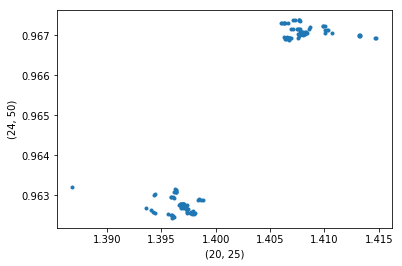

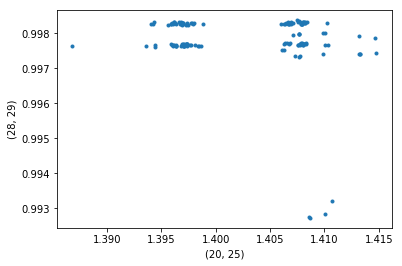

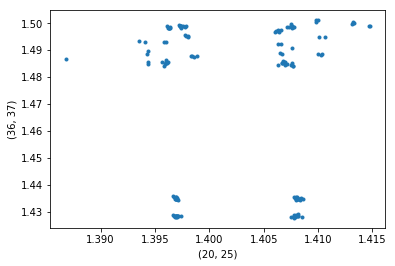

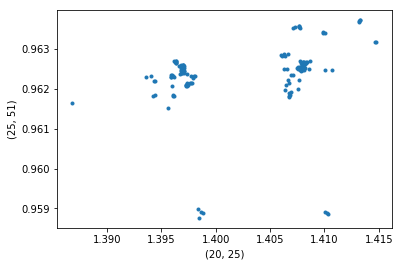

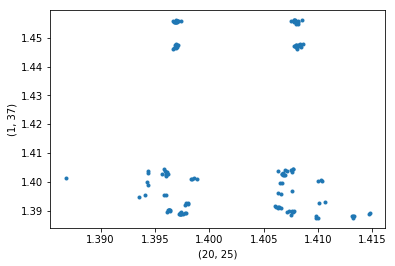

...

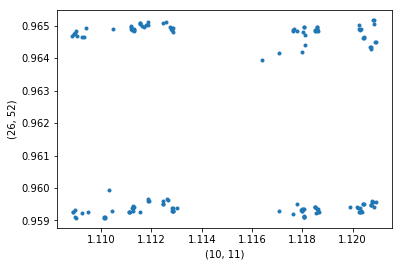

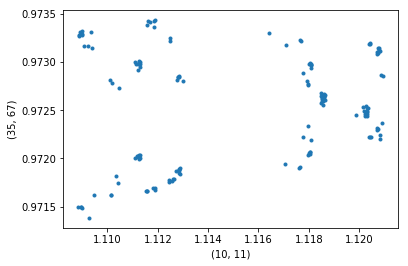

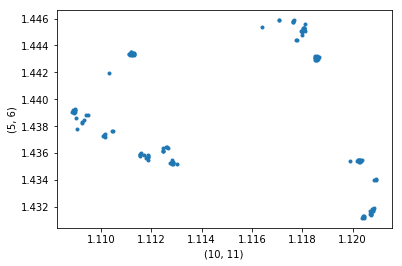

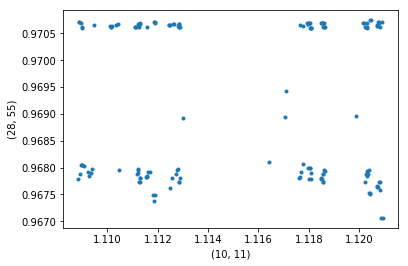

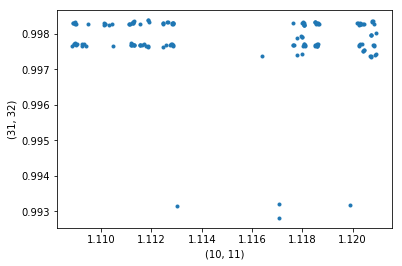

In [19]:
correlation_coef = np.zeros((len(bonds), len(bonds)))
for i, j in itertools.combinations(bonds, 2):
    plt.figure()
    plt.scatter(bond_orders_arrays['Wiberg'][:, i[0]-1, i[1]-1],
         bond_orders_arrays['Wiberg'][:, j[0]-1, j[1]-1], '.')
    
    plt.xlabel(i)
    plt.ylabel(j)
        
    

In [13]:
molecule, atom_map = utils.get_atom_map(tagged_smiles=tagged_smiles['Dasatinib'])
bonds = set()
for conformation in bond_orders_arrays['Dasatinib']['Wiberg']:
    bonds.update(utils.bond_order_to_bond_graph(conformation, hydrogen_bond=False, molecule=molecule, 
                                            atom_map=atom_map, threshold=0.83))
bonds = list((bonds))
bonds = sorted(bonds, key=lambda element: (element[0], element[1]))

In [102]:
for mol in mollist:
    name = mol.GetTitle()
    print(name)
    if name not in tagged_smiles:
        continue
    molecule, atom_map = utils.get_atom_map(tagged_smiles=tagged_smiles[name])
    bonds = set()
    if bond_orders_arrays[name]['Wiberg'].shape[0] <=3:
        print('{} only has {} converged conformations. Not analyzing'.format(name, 
                                                                    bond_orders_arrays[name]['Wiberg'].shape[0]))
        continue
    for conformation in bond_orders_arrays[name]['Wiberg']:
        bonds.update(utils.bond_order_to_bond_graph(conformation, hydrogen_bond=False, molecule=molecule, 
                                                atom_map=atom_map, threshold=0.83))
    bonds = list((bonds))
    bonds = sorted(bonds, key=lambda element: (element[0], element[1]))  
    
    rot_bonds = []
    for bond in molecule.GetBonds():
        if bond.IsAromatic():
            a1 = bond.GetBgn().GetMapIdx()
            a2 = bond.GetEnd().GetMapIdx()
            rot_bonds.append((a1, a2))
    rot_bonds = sorted(rot_bonds, key=lambda element: (element[0], element[1])) 
    chunks = len(rot_bonds)/8
    if not chunks.is_integer():
        chunks += 1
    with PdfPages("{}_aromatic_bond_corrs.pdf".format(name)) as pdf:
        plt.figure()
        
        plt.subplot2grid((1,3), (0,0))
        img = mpimg.imread('bond_order_without_geomopt/{}_mapped.png'.format(name))
        imgplot = plt.imshow(img, interpolation='none')
        plt.xticks([])
        plt.yticks([])
        #plt.tight_layout()
        
        plt.subplot2grid((1,3), (0,1), colspan=2)
        img = mpimg.imread('images/{}_WBO_aromatic_correlation.png'.format(name))
        imgplot = plt.imshow(img, interpolation='none')
        plt.xticks([])
        plt.yticks([])
        plt.tight_layout() 
        pdf.savefig(bbox_inches='tight',pad_inches = 0.1)
        plt.close()
        for p in range(int(chunks)):
            plt.figure()
            plt.suptitle('{}, {} conformations'.format(name, bond_orders_arrays[name]['Wiberg'].shape[0]))
            for q in range(9):
                if q == 0:
                    plt.subplot2grid((3,3), (0,0), colspan=1);
                    img = mpimg.imread('bond_order_without_geomopt/{}_mapped.png'.format(name))
                    imgplot = plt.imshow(img, interpolation='none')
                    plt.xticks([])
                    plt.yticks([])
                    #plt.tight_layout()
                #elif q == 1:
                #    plt.subplot2grid((3,3), (0,2), colspan=1);
                #    img = mpimg.imread('images/{}_rdkit_res.png'.format(name))
                #    imgplot = plt.imshow(img, interpolation='none')
                #    plt.xticks([])
                #    plt.yticks([])
                #    plt.title('RDKit resonance model')
                #    plt.tight_layout()
                #elif q == 1:
                #    plt.subplot2grid((3,3), (0, 1), colspan=2);
                #    img = mpimg.imread('images/{}_oe_labeled_1.05.png'.format(name))
                #    imgplot = plt.imshow(img, interpolation='none')
                #    plt.xticks([])
                #    plt.yticks([])
                #    plt.title('OpenEye WBO 1.05 thresh')
                    #plt.tight_layout()

                else:
                    try:
                        bond = rot_bonds[8*p + (q-1)]
                        plt.subplot(3, 3, q+1);
                    except IndexError:
                        break
                    #plt.title(bond)
                    for n, j in enumerate(bonds):
                        corr_coef = np.corrcoef(bond_orders_arrays[name]['Wiberg'][:, bond[0]-1, bond[1]-1], 
                                                bond_orders_arrays[name]['Wiberg'][:, j[0]-1, j[1]-1])
                        if abs(corr_coef[0,1]) > 0.6 and bond != j and bond != (j[1], j[0]):
                            plt.plot(bond_orders_arrays[name]['Wiberg'][:, bond[0]-1, bond[1]-1],
                                 bond_orders_arrays[name]['Wiberg'][:, j[0]-1, j[1]-1], '.', 
                                     label='{}, {number:.{digits}f}'.format(j, number=corr_coef[0,1], digits=2),
                                    markersize=2.0)
                            plt.legend(fontsize=8.5)
                            plt.title(bond)
                            #plt.tight_layout()
            pdf.savefig(bbox_inches='tight',pad_inches = 0.1)
            plt.close()
        



Imatinib
Dasatinib
Nilotinib
Bosutinib
Ponatinib
Gefitinib
Erlotinib
Afatinib
Lapatinib
Sorafenib
Sunitinib
Pazopanib
Vandetanib
Axitinib
Regorafenib
Crizotinib
Ceritinib
Vemurafenib
Dabrafenib
Ruxolitinib
Tofacitinib
Cabozantinib
Ibrutinib
Nintedanib
Trametinib
Idelalisib
Lenvatinib
Palbociclib
Cobimetinib
Osimertinib
Alectinib
Alectinib only has 2 converged conformations. Not analyzing
Brigatinib
Cabozantinib
Midostaurin
Midostaurin only has 2 converged conformations. Not analyzing
Neratinib
Abemaciclib
Acalabrutinib
Ribociclib


In [274]:
plots=3
for mol in mollist:
    name = mol.GetTitle()
    print(name)
    if name not in tagged_smiles:
        continue
    molecule, atom_map = utils.get_atom_map(tagged_smiles=tagged_smiles[name])
    bonds = set()
    if bond_orders_arrays[name]['Wiberg'].shape[0] <=3 or name == 'Nilotinib':
        print('{} only has {} converged conformations. Not analyzing'.format(name, 
                                                                    bond_orders_arrays[name]['Wiberg'].shape[0]))
        continue
    for conformation in bond_orders_arrays[name]['Wiberg']:
        bonds.update(utils.bond_order_to_bond_graph(conformation, hydrogen_bond=False, molecule=molecule, 
                                                atom_map=atom_map, threshold=0.83))
    bonds = list((bonds))
    bonds = sorted(bonds, key=lambda element: (element[0], element[1]))  
    
    rot_bonds = []
    for bond in molecule.GetBonds():
        if bond.IsRotor():
            a1 = bond.GetBgn().GetMapIdx()
            a2 = bond.GetEnd().GetMapIdx()
            rot_bonds.append((a1, a2))
    rot_bonds = sorted(rot_bonds, key=lambda element: (element[0], element[1])) 
    chunks = len(rot_bonds)/plots
    if not chunks.is_integer():
        chunks += 1
    with PdfPages("{}_bonds_correlation.pdf".format(name)) as pdf:
        plt.figure()
        
        plt.subplot2grid((1,3), (0,0))
        img = mpimg.imread('bond_order_without_geomopt/{}_mapped.png'.format(name))
        imgplot = plt.imshow(img, interpolation='none')
        plt.xticks([])
        plt.yticks([])
        #plt.tight_layout()
        
        plt.subplot2grid((1,3), (0,1), colspan=2)
        img = mpimg.imread('images/{}_WBO_correlation.png'.format(name))
        imgplot = plt.imshow(img, interpolation='none')
        plt.xticks([])
        plt.yticks([])
        plt.tight_layout() 
        pdf.savefig(bbox_inches='tight',pad_inches = 0.1)
        plt.close()
        for p in range(int(chunks)):
            plt.figure()
            plt.suptitle('{}, {} conformations'.format(name, bond_orders_arrays[name]['Wiberg'].shape[0]))
            for q in range(5):
                if q == 0:
                    plt.subplot2grid((2,3), (0,2), colspan=1);
                    img = mpimg.imread('bond_order_without_geomopt/{}_mapped.png'.format(name))
                    imgplot = plt.imshow(img, interpolation='none')
                    plt.xticks([])
                    plt.yticks([])
                    #plt.tight_layout()
                #elif q == 1:
                #    plt.subplot2grid((3,3), (0,2), colspan=1);
                #    img = mpimg.imread('images/{}_rdkit_res.png'.format(name))
                #    imgplot = plt.imshow(img, interpolation='none')
                #    plt.xticks([])
                #    plt.yticks([])
                #    plt.title('RDKit resonance model')
                #    plt.tight_layout()
                elif q == 1:
                    plt.subplot2grid((2,3), (0, 0), colspan=2);
                    img = mpimg.imread('images/{}_oe_labeled_1.05.png'.format(name))
                    imgplot = plt.imshow(img, interpolation='none')
                    plt.xticks([])
                    plt.yticks([])
                    plt.title('OpenEye WBO 1.05 thresh')
                    #plt.tight_layout()

                else:
                    try:
                        bond = rot_bonds[3*p + (q-2)]
                        plt.subplot(2, 3, q+2);
                        plt.title(bond)
                    except IndexError:
                        break
                    #plt.title(bond)
                    for n, j in enumerate(bonds):
                        corr_coef = np.corrcoef(bond_orders_arrays[name]['Wiberg'][:, bond[0]-1, bond[1]-1], 
                                                bond_orders_arrays[name]['Wiberg'][:, j[0]-1, j[1]-1])
                        if abs(corr_coef[0,1]) > 0.6 and bond != j and bond != (j[1], j[0]):
                            plt.plot(bond_orders_arrays[name]['Wiberg'][:, bond[0]-1, bond[1]-1],
                                 bond_orders_arrays[name]['Wiberg'][:, j[0]-1, j[1]-1], '.', 
                                     label='{}, {number:.{digits}f}'.format(j, number=corr_coef[0,1], digits=2),
                                    markersize=2.5)
                            plt.legend(fontsize=9.5)
                            plt.tight_layout()
            pdf.savefig(bbox_inches='tight',pad_inches = 0.1)
            plt.close()
        


Imatinib
Dasatinib
Nilotinib
Nilotinib only has 261 converged conformations. Not analyzing
Bosutinib
Ponatinib
Gefitinib
Erlotinib
Afatinib
Lapatinib
Sorafenib
Sunitinib
Pazopanib
Vandetanib
Axitinib
Regorafenib
Crizotinib
Ceritinib
Vemurafenib
Dabrafenib
Ruxolitinib
Tofacitinib
Cabozantinib
Ibrutinib
Nintedanib
Trametinib
Idelalisib
Lenvatinib
Palbociclib
Cobimetinib
Osimertinib
Alectinib
Alectinib only has 2 converged conformations. Not analyzing
Brigatinib
Cabozantinib
Midostaurin
Midostaurin only has 2 converged conformations. Not analyzing
Neratinib
Abemaciclib
Acalabrutinib
Ribociclib


In [292]:
with PdfPages("WBO_correlations.pdf".format(name)) as pdf:
    for mol in mollist:
        name = mol.GetTitle()
        print(name)
        if name not in tagged_smiles:
            continue
        plt.figure()

        plt.subplot2grid((1,3), (0,0))
        img = mpimg.imread('bond_order_without_geomopt/{}_mapped.png'.format(name))
        imgplot = plt.imshow(img, interpolation='none')
        plt.xticks([])
        plt.yticks([])
        plt.title(name)
        #plt.tight_layout()

        plt.subplot2grid((1,3), (0,1), colspan=2)
        img = mpimg.imread('images/{}_WBO_correlation.png'.format(name))
        imgplot = plt.imshow(img, interpolation='none')
        plt.xticks([])
        plt.yticks([])
        plt.tight_layout() 
        pdf.savefig(bbox_inches='tight',pad_inches = 0.1)
        plt.close()

Imatinib
Dasatinib
Nilotinib
Bosutinib
Ponatinib
Gefitinib
Erlotinib
Afatinib
Lapatinib
Sorafenib
Sunitinib
Pazopanib
Vandetanib
Axitinib
Regorafenib
Crizotinib
Ceritinib
Vemurafenib
Dabrafenib
Ruxolitinib
Tofacitinib
Cabozantinib
Ibrutinib
Nintedanib
Trametinib
Idelalisib
Lenvatinib
Palbociclib
Cobimetinib
Osimertinib
Alectinib
Brigatinib
Cabozantinib
Midostaurin
Neratinib
Abemaciclib
Acalabrutinib
Ribociclib


In [4]:
# histograming
# First, how many rot bonds are considered conjugated by RDKit, OE (at several cutoffs) and neither. 
skip = ['Nilotinib', 'Alectinib', 'Midostaurin', 'Ponatinib', 'Trametinib', 'Cobimetinib','Acalabrutinib']


In [5]:
def count_conj_bonds(charged_mollist, thresh):
    rot_conj = 0
    rot_nonconj = 0
    for mol in charged_mollist:
        for bond in mol.GetBonds():
            if bond.IsRotor():
                if bond.GetData('WibergBondOrder') > thresh:
                    rot_conj +=1
                else:
                    rot_nonconj +=1
    return rot_conj, rot_nonconj

In [7]:
charged_mollist = []
for mol in mollist:
    name = mol.GetTitle()
    if name in skip:
        continue
    else:
        charged = openeye.get_charges(mol)
        charged.SetTitle(mol.GetTitle())
        print(charged.GetTitle())
        charged_mollist.append(charged)

Imatinib
Dasatinib
Bosutinib
Gefitinib
Erlotinib
Afatinib
Lapatinib
Sorafenib
Sunitinib
Pazopanib
Vandetanib
Axitinib
Regorafenib
Crizotinib
Ceritinib
Vemurafenib
Dabrafenib
Ruxolitinib
Tofacitinib
Cabozantinib
Ibrutinib
Nintedanib
Idelalisib
Lenvatinib
Palbociclib
Osimertinib
Brigatinib
Cabozantinib
Neratinib
Abemaciclib
Ribociclib


In [8]:
oe_conj_01, oe_nconj_01 = count_conj_bonds(charged_mollist, 1.01)
oe_conj_02, oe_nconj_02 = count_conj_bonds(charged_mollist, 1.02)
oe_conj_03, oe_nconj_03 = count_conj_bonds(charged_mollist, 1.03)
oe_conj_04, oe_nconj_04 = count_conj_bonds(charged_mollist, 1.04)
oe_conj_05, oe_nconj_05 = count_conj_bonds(charged_mollist, 1.05)


In [9]:
plt.bar(np.arange(5), height=[oe_conj_01, oe_conj_02, oe_conj_03, oe_conj_04, oe_conj_05])

<BarContainer object of 5 artists>

In [ ]:
rdkit_conj = 0
rdkit_nconj = 0
rdkit_mols = Chem.SmilesMolSupplier('kinase_inhibitors_rd.smi')
for mol in rdkit_mols:
    if mol.GetProp("_Name") in skip:
        continue
    # Find rotatable bonds
    atom_tuples = mol.GetSubstructMatches(RotatableBondSmarts)
    rotatable_bonds = []
    for a1, a2 in atom_tuples:
        bond = mol.GetBondBetweenAtoms(a1, a2)
        rotatable_bonds.append(bond.GetIdx())
        if bond.GetIsConjugated():
            rdkit_conj +=1
        if not bond.GetIsConjugated():
            rdkit_nconj +=1


In [ ]:
print(rdkit_conj)
print(rdkit_nconj)
print(oe_conj_01)
print(oe_nconj_01)

In [12]:
print(rdkit_conj + rdkit_nconj)
print(oe_conj_01 + oe_nconj_01)
print(oe_conj_02 + oe_nconj_02)

238
238
238


In [6]:
def inverse_mapping(f):
    return f.__class__(map(reversed, f.items()))

In [14]:
df = pd.DataFrame(columns=['molecule', 'bond', 'oe_wbo', 'rdkit'])
to_dataframe = {'molecule': [], 'bond': [], 'oe_wbo': [], 'rdkit': []}
oe_bond_order = {}
rdkit_conj = {}
for oemol, rdmol in zip(charged_mollist, rdkit_mols):
    name_rd = rdmol.GetProp("_Name")
    name_oe = oemol.GetTitle()
    print('rd: {}'.format(name_rd))
    print('oe: {}'.format(name_oe))
    if name_rd in skip:
        continue
    if name_rd != name_oe:
        print(name_rd)
        print(name_oe)
        print('Something is very off')
        break
    #First get maps
    molecule, oe_map = utils.get_atom_map(tagged_smiles[name_oe], molecule=oemol)
    map_idx_to_map = inverse_mapping(oe_map)
    rdkit_map = {}
    rdmol_new = Chem.MolFromSmarts(tagged_smiles[name])
    Chem.GetSSSR(rdmol_new)
    for atom in rdmol.GetAtoms():
        rdkit_map[atom.GetAtomMapNum()] = atom.GetIdx()
    rdkit_inv_map = inverse_mapping(rdkit_map)
    for bond in oemol.GetBonds():
        if bond.IsRotor():
            bond_tuple = (map_idx_to_map[bond.GetBgnIdx()], map_idx_to_map[bond.GetEndIdx()])
            df = df.append({'molecule': name_oe, 'bond': bond_tuple, 'oe_wbo':bond.GetData()['WibergBondOrder']}, 
                           ignore_index=True)
    print(df)
    # Get RDKit bonds
    #atom_tuples = rdmol_new.GetSubstructMatches(RotatableBondSmarts)
    #rotatable_bonds = [] 
    #for a1, a2 in atom_tuples:
    #    bond = rdmol.GetBondBetweenAtoms(a1, a2)
    #    rdkit = bond.GetIsConjugated()
    #    bond = (rdkit_inv_map[a1], rdkit_inv_map[a2])
    #    print(bond)
    #    df.loc[(df['molecule']==name) & (df['bond']==bond), 'rdkit'] = rdkit
    #print(df)

        

rd: Imatinib
oe: Imatinib
22:44:05 INFO fragmenter: Substructure search took 0.00015997886657714844 seconds
22:44:05 INFO fragmenter: Match SMILES: [H:41][c:7]1[c:8]([c:3]([c:4]([n:5][c:6]1[H:40])[H:39])[c:2]2[c:1]([c:37]([n:36][c:10]([n:9]2)[N:11]([H:43])[c:12]3[c:17]([c:16]([c:15]([c:14]([c:13]3[C:35]([H:65])([H:66])[H:67])[H:44])[H:45])[N:18]([H:47])[C:19](=[O:34])[c:20]4[c:25]([c:24]([c:23]([c:22]([c:21]4[H:48])[H:49])[C:26]([H:52])([H:53])[N:27]5[C:32]([C:31]([N:30]([C:29]([C:28]5([H:54])[H:55])([H:56])[H:57])[C:33]([H:62])([H:63])[H:64])([H:58])[H:59])([H:60])[H:61])[H:50])[H:51])[H:46])[H:68])[H:38])[H:42]
   molecule      bond    oe_wbo  rdkit
0  Imatinib    (3, 2)  0.981002    NaN
1  Imatinib  (10, 11)  1.117327    NaN
2  Imatinib  (11, 12)  1.006345    NaN
3  Imatinib  (16, 18)  1.019243    NaN
4  Imatinib  (18, 19)  1.057866    NaN
5  Imatinib  (19, 20)  0.932429    NaN
6  Imatinib  (23, 26)  0.972099    NaN
7  Imatinib  (26, 27)  0.970884    NaN
rd: Dasatinib
oe: Dasatinib


22:44:06 INFO fragmenter: Match SMILES: [H:53][c:26]1[c:25]([c:24]([c:23]([c:22]([c:21]1[N:20]([H:50])[c:16]2[c:14]3[c:15]([c:10]([c:11]([c:12]([c:13]3[n:19][c:18]([n:17]2)[H:49])[H:47])[O:29][C@:30]4([C:32]([C:33]([O:34][C:35]4([H:58])[H:59])([H:56])[H:57])([H:54])[H:55])[H:31])[N:9]([H:46])[C:7](=[O:8])[C:6](=[C:5]([H:44])[C:4]([H:42])([H:43])[N:2]([C:1]([H:36])([H:37])[H:38])[C:3]([H:39])([H:40])[H:41])[H:45])[H:48])[H:51])[Cl:28])[F:27])[H:52]
     molecule      bond    oe_wbo  rdkit
0    Imatinib    (3, 2)  0.981002    NaN
1    Imatinib  (10, 11)  1.117327    NaN
2    Imatinib  (11, 12)  1.006345    NaN
3    Imatinib  (16, 18)  1.019243    NaN
4    Imatinib  (18, 19)  1.057866    NaN
5    Imatinib  (19, 20)  0.932429    NaN
6    Imatinib  (23, 26)  0.972099    NaN
7    Imatinib  (26, 27)  0.970884    NaN
8   Dasatinib  (26, 25)  0.988287    NaN
9   Dasatinib  (25, 23)  1.055545    NaN
10  Dasatinib   (23, 2)  0.940932    NaN
11  Dasatinib    (4, 6)  1.071554    NaN
12  Dasatinib  

22:44:06 INFO fragmenter: Substructure search took 0.0001289844512939453 seconds
22:44:06 INFO fragmenter: Match SMILES: [H:52][c:23]1[c:22]([c:21]([c:20]([c:19]2[c:24]1[N:25]([C:26](=[O:27])[C:18]2=[C:17]([H:49])[c:13]3[c:12]([c:11]([c:15]([n:14]3[H:45])[C:16]([H:46])([H:47])[H:48])[C:9](=[O:10])[N:8]([H:44])[C:7]([H:42])([H:43])[C:6]([H:40])([H:41])[N:3]([C:2]([H:33])([H:34])[C:1]([H:30])([H:31])[H:32])[C:4]([H:35])([H:36])[C:5]([H:37])([H:38])[H:39])[C:29]([H:54])([H:55])[H:56])[H:53])[H:50])[F:28])[H:51]
     molecule      bond    oe_wbo  rdkit
0    Imatinib    (3, 2)  0.981002    NaN
1    Imatinib  (10, 11)  1.117327    NaN
2    Imatinib  (11, 12)  1.006345    NaN
3    Imatinib  (16, 18)  1.019243    NaN
4    Imatinib  (18, 19)  1.057866    NaN
5    Imatinib  (19, 20)  0.932429    NaN
6    Imatinib  (23, 26)  0.972099    NaN
7    Imatinib  (26, 27)  0.970884    NaN
8   Dasatinib  (26, 25)  0.988287    NaN
9   Dasatinib  (25, 23)  1.055545    NaN
10  Dasatinib   (23, 2)  0.940932  

22:44:06 INFO fragmenter: Match SMILES: [H:34][c:7]1[c:8]([c:9]([c:10]([c:5]([c:6]1[H:33])[C:3](=[O:4])[N:2]([H:32])[C:1]([H:29])([H:30])[H:31])[S:11][c:12]2[c:13]([c:14]([c:15]3[c:16]([c:17]2[H:39])[n:18]([n:19][c:20]3[C:21](=[C:22]([H:42])[c:23]4[c:24]([c:25]([c:26]([c:27]([n:28]4)[H:46])[H:45])[H:44])[H:43])[H:41])[H:40])[H:38])[H:37])[H:36])[H:35]
      molecule      bond    oe_wbo  rdkit
0     Imatinib    (3, 2)  0.981002    NaN
1     Imatinib  (10, 11)  1.117327    NaN
2     Imatinib  (11, 12)  1.006345    NaN
3     Imatinib  (16, 18)  1.019243    NaN
4     Imatinib  (18, 19)  1.057866    NaN
5     Imatinib  (19, 20)  0.932429    NaN
6     Imatinib  (23, 26)  0.972099    NaN
7     Imatinib  (26, 27)  0.970884    NaN
8    Dasatinib  (26, 25)  0.988287    NaN
9    Dasatinib  (25, 23)  1.055545    NaN
10   Dasatinib   (23, 2)  0.940932    NaN
11   Dasatinib    (4, 6)  1.071554    NaN
12   Dasatinib    (6, 7)  1.029504    NaN
13   Dasatinib   (9, 14)  1.041401    NaN
14   Dasatinib  

22:44:06 INFO fragmenter: Match SMILES: [H:65][c:28]1[c:29]([c:30]([c:31]([c:26]([c:27]1[H:64])[N:25]([H:63])[c:23]2[c:22]([c:21]([n:20][c:19]([n:24]2)[N:18]([H:61])[c:4]3[c:3]([c:2]([c:7]([c:6]([c:5]3[O:14][C:15]([H:54])([C:16]([H:55])([H:56])[H:57])[C:17]([H:58])([H:59])[H:60])[H:43])[C:8]4([C:13]([C:12]([N:11]([C:10]([C:9]4([H:45])[H:46])([H:47])[H:48])[H:49])([H:50])[H:51])([H:52])[H:53])[H:44])[C:1]([H:39])([H:40])[H:41])[H:42])[H:62])[Cl:38])[S:32](=[O:33])(=[O:34])[C:35]([H:68])([C:36]([H:69])([H:70])[H:71])[C:37]([H:72])([H:73])[H:74])[H:67])[H:66]
        molecule      bond    oe_wbo  rdkit
0       Imatinib    (3, 2)  0.981002    NaN
1       Imatinib  (10, 11)  1.117327    NaN
2       Imatinib  (11, 12)  1.006345    NaN
3       Imatinib  (16, 18)  1.019243    NaN
4       Imatinib  (18, 19)  1.057866    NaN
5       Imatinib  (19, 20)  0.932429    NaN
6       Imatinib  (23, 26)  0.972099    NaN
7       Imatinib  (26, 27)  0.970884    NaN
8      Dasatinib  (26, 25)  0.988287    N

[133 rows x 4 columns]
rd: Ruxolitinib
oe: Ruxolitinib
22:44:06 INFO fragmenter: Substructure search took 0.0008952617645263672 seconds
22:44:06 INFO fragmenter: Match SMILES: [H:25][c:1]1[c:2]([n:3]([c:4]2[c:5]1[c:6]([n:7][c:8]([n:9]2)[H:28])[c:10]3[c:11]([n:12][n:13]([c:14]3[H:30])[C@:15]([H:16])([C:20]4([C:24]([C:23]([C:22]([C:21]4([H:34])[H:35])([H:36])[H:37])([H:38])[H:39])([H:40])[H:41])[H:33])[C:17]([H:31])([H:32])[C:18]#[N:19])[H:29])[H:27])[H:26]
        molecule      bond    oe_wbo  rdkit
0       Imatinib    (3, 2)  0.981002    NaN
1       Imatinib  (10, 11)  1.117327    NaN
2       Imatinib  (11, 12)  1.006345    NaN
3       Imatinib  (16, 18)  1.019243    NaN
4       Imatinib  (18, 19)  1.057866    NaN
5       Imatinib  (19, 20)  0.932429    NaN
6       Imatinib  (23, 26)  0.972099    NaN
7       Imatinib  (26, 27)  0.970884    NaN
8      Dasatinib  (26, 25)  0.988287    NaN
9      Dasatinib  (25, 23)  1.055545    NaN
10     Dasatinib   (23, 2)  0.940932    NaN
11     Dasat

22:44:06 INFO fragmenter: Match SMILES: [H:52][c:27]1[c:28]([c:29]([c:24]([c:25]([c:26]1[H:51])[H:50])[O:23][c:20]2[c:21]([c:22]([c:17]([c:18]([c:19]2[H:47])[H:46])[c:15]3[c:14]4[c:13]([n:33][c:32]([n:31][c:30]4[N:34]([H:56])[H:57])[H:55])[n:12]([n:16]3)[C@:9]5([C:8]([C:7]([C:6]([N:5]([C:11]5([H:44])[H:45])[C:3](=[O:4])[C:2](=[C:1]([H:35])[H:36])[H:37])([H:38])[H:39])([H:40])[H:41])([H:42])[H:43])[H:10])[H:49])[H:48])[H:54])[H:53]
         molecule      bond    oe_wbo  rdkit
0        Imatinib    (3, 2)  0.981002    NaN
1        Imatinib  (10, 11)  1.117327    NaN
2        Imatinib  (11, 12)  1.006345    NaN
3        Imatinib  (16, 18)  1.019243    NaN
4        Imatinib  (18, 19)  1.057866    NaN
5        Imatinib  (19, 20)  0.932429    NaN
6        Imatinib  (23, 26)  0.972099    NaN
7        Imatinib  (26, 27)  0.970884    NaN
8       Dasatinib  (26, 25)  0.988287    NaN
9       Dasatinib  (25, 23)  1.055545    NaN
10      Dasatinib   (23, 2)  0.940932    NaN
11      Dasatinib    (4, 

22:44:06 INFO fragmenter: Substructure search took 0.00016999244689941406 seconds
22:44:06 INFO fragmenter: Match SMILES: [H:41][c:21]1[c:22]([c:17]([c:18]([c:19]([c:20]1[N:23]([H:43])[C:24](=[O:25])[N:26]([H:44])[C:27]2([C:29]([C:28]2([H:46])[H:47])([H:48])[H:49])[H:45])[Cl:30])[H:40])[O:16][c:9]3[c:8]([c:7]([n:6][c:5]4[c:10]3[c:11]([c:12]([c:3]([c:4]4[H:34])[O:2][C:1]([H:31])([H:32])[H:33])[C:13](=[O:14])[N:15]([H:38])[H:39])[H:37])[H:35])[H:36])[H:42]
         molecule      bond    oe_wbo  rdkit
0        Imatinib    (3, 2)  0.981002    NaN
1        Imatinib  (10, 11)  1.117327    NaN
2        Imatinib  (11, 12)  1.006345    NaN
3        Imatinib  (16, 18)  1.019243    NaN
4        Imatinib  (18, 19)  1.057866    NaN
5        Imatinib  (19, 20)  0.932429    NaN
6        Imatinib  (23, 26)  0.972099    NaN
7        Imatinib  (26, 27)  0.970884    NaN
8       Dasatinib  (26, 25)  0.988287    NaN
9       Dasatinib  (25, 23)  1.055545    NaN
10      Dasatinib   (23, 2)  0.940932    NaN
1

22:44:06 INFO fragmenter: Substructure search took 0.00015807151794433594 seconds
22:44:06 INFO fragmenter: Match SMILES: [H:68][c:30]1[c:31]([c:32]([c:33]([c:28]([c:29]1[H:67])[N:27]([H:66])[c:25]2[c:24]([c:23]([n:22][c:21]([n:26]2)[N:20]([H:64])[c:17]3[c:18]([c:19]([c:14]([c:15]([c:16]3[O:39][C:40]([H:77])([H:78])[H:79])[H:61])[N:11]4[C:12]([C:13]([C:8]([C:9]([C:10]4([H:55])[H:56])([H:53])[H:54])([H:52])[N:5]5[C:6]([C:7]([N:2]([C:3]([C:4]5([H:46])[H:47])([H:44])[H:45])[C:1]([H:41])([H:42])[H:43])([H:50])[H:51])([H:48])[H:49])([H:59])[H:60])([H:57])[H:58])[H:63])[H:62])[H:65])[Cl:38])[P:34](=[O:35])([C:36]([H:71])([H:72])[H:73])[C:37]([H:74])([H:75])[H:76])[H:70])[H:69]
        molecule      bond    oe_wbo  rdkit
0       Imatinib    (3, 2)  0.981002    NaN
1       Imatinib  (10, 11)  1.117327    NaN
2       Imatinib  (11, 12)  1.006345    NaN
3       Imatinib  (16, 18)  1.019243    NaN
4       Imatinib  (18, 19)  1.057866    NaN
5       Imatinib  (19, 20)  0.932429    NaN
6       Imat

22:44:07 INFO fragmenter: Match SMILES: [H:49][c:9]1[c:10]([c:11]([n:34][c:35]([c:8]1[C:7]([H:47])([H:48])[N:6]2[C:36]([C:37]([N:3]([C:4]([C:5]2([H:45])[H:46])([H:43])[H:44])[C:2]([H:41])([H:42])[C:1]([H:38])([H:39])[H:40])([H:68])[H:69])([H:66])[H:67])[H:65])[N:12]([H:51])[c:13]3[n:14][c:15]([c:16]([c:18]([n:19]3)[c:20]4[c:33]([c:32]5[c:24]([c:22]([c:21]4[H:53])[F:23])[n:25][c:26]([n:28]5[C:29]([H:57])([C:30]([H:58])([H:59])[H:60])[C:31]([H:61])([H:62])[H:63])[C:27]([H:54])([H:55])[H:56])[H:64])[F:17])[H:52])[H:50]
         molecule      bond    oe_wbo  rdkit
0        Imatinib    (3, 2)  0.981002    NaN
1        Imatinib  (10, 11)  1.117327    NaN
2        Imatinib  (11, 12)  1.006345    NaN
3        Imatinib  (16, 18)  1.019243    NaN
4        Imatinib  (18, 19)  1.057866    NaN
5        Imatinib  (19, 20)  0.932429    NaN
6        Imatinib  (23, 26)  0.972099    NaN
7        Imatinib  (26, 27)  0.970884    NaN
8       Dasatinib  (26, 25)  0.988287    NaN
9       Dasatinib  (25, 23) 

In [64]:
df.to_csv('wbo_rdkit.csv')

In [61]:
rdkit_mols = Chem.SmilesMolSupplier('kinase_inhibitors_rd.smi')

for  rdmol in rdkit_mols:
    name_rd = rdmol.GetProp("_Name")
    #name_oe = oemol.GetTitle()
    print('rd: {}'.format(name_rd))
    #print('oe: {}'.format(name_oe))
    if name_rd in skip:
        continue
    #First get maps
    #molecule, oe_map = utils.get_atom_map(tagged_smiles[name_oe], molecule=oemol)
    #map_idx_to_map = inverse_mapping(oe_map)
    rdkit_map = {}
    rdmol_new = Chem.MolFromSmiles(tagged_smiles[name_rd])
    for atom in rdmol_new.GetAtoms():
        rdkit_map[atom.GetAtomMapNum()] = atom.GetIdx()
    rdkit_inv_map = inverse_mapping(rdkit_map)
# Get RDKit bonds
    atom_tuples = rdmol_new.GetSubstructMatches(RotatableBondSmarts)
    rotatable_bonds = [] 
    for a1, a2 in atom_tuples:
        bond = rdmol_new.GetBondBetweenAtoms(a1, a2)
        rdkit = bond.GetIsConjugated()
        bond_idx = '({}, {})'.format(rdkit_inv_map[a1], rdkit_inv_map[a2])
        
        df.loc[(df['molecule']==name_rd) & (df['bond']==bond_idx), 'rdkit'] = rdkit


rd: Imatinib
rd: Dasatinib
rd: Bosutinib
rd: Gefitinib
rd: Erlotinib
rd: Afatinib
rd: Lapatinib
rd: Sorafenib
rd: Sunitinib
rd: Pazopanib
rd: Vandetanib
rd: Axitinib
rd: Regorafenib
rd: Crizotinib
rd: Ceritinib
rd: Vemurafenib
rd: Dabrafenib
rd: Ruxolitinib
rd: Tofacitinib
rd: Cabozantinib
rd: Ibrutinib
rd: Nintedanib
rd: Idelalisib
rd: Lenvatinib
rd: Palbociclib
rd: Osimertinib
rd: Brigatinib
rd: Cabozantinib
rd: Neratinib
rd: Abemaciclib
rd: Ribociclib


In [90]:
df

,molecule,bond,oe_wbo,rdkit
0,Imatinib,"(3, 2)",0.981002,True
1,Imatinib,"(10, 11)",1.117327,True
2,Imatinib,"(11, 12)",1.006345,True
3,Imatinib,"(16, 18)",1.019243,True
4,Imatinib,"(18, 19)",1.057866,True
5,Imatinib,"(19, 20)",0.932429,True
6,Imatinib,"(23, 26)",0.972099,False
7,Imatinib,"(26, 27)",0.970884,False
8,Dasatinib,"(26, 25)",0.988287,True
9,Dasatinib,"(25, 23)",1.055545,True


In [142]:
for i, thresh in enumerate([1.0, 1.01, 1.02, 1.03, 1.04, 1.05, 1.2]):
    
    oe_rdkit = len(df[(df['oe_wbo'] > thresh) & (df['rdkit'] == True)])
    oe = len(df[(df['oe_wbo'] > thresh) & (df['rdkit'] == False)])
    rdkit = len(df[(df['oe_wbo'] < thresh) & (df['rdkit'] == True)])
    no_oe_rdkit = len(df[(df['oe_wbo'] < thresh) & (df['rdkit'] == False)])
    plt.bar(np.arange(4)+i*0.1, [oe_rdkit, rdkit, oe, no_oe_rdkit], label="thresh: {}".format(thresh), width=0.1)
plt.legend(loc=(0.55,0.53))
plt.xticks(np.arange(4)+0.25, ['OE & RDkit', 'RDKit only', 'OE only', 'Not conjugated']);
plt.ylabel("counts of bonds")
plt.title("number of conjugated bonds by threshold and method");
plt.savefig('conjugation_bar_graph.png')

In [101]:
df[(df['oe_wbo']<1.05) & (df['rdkit']==False)]

,molecule,bond,oe_wbo,rdkit
6,Imatinib,"(23, 26)",0.972099,False
7,Imatinib,"(26, 27)",0.970884,False
14,Dasatinib,"(17, 20)",0.967115,False
15,Dasatinib,"(20, 21)",0.964302,False
18,Bosutinib,"(24, 25)",0.932927,False
19,Bosutinib,"(25, 26)",0.976852,False
20,Bosutinib,"(26, 27)",0.971445,False
21,Bosutinib,"(27, 28)",0.972731,False
29,Gefitinib,"(9, 10)",0.945331,False
30,Gefitinib,"(10, 11)",0.976871,False


In [102]:
df[df['rdkit']==False]

,molecule,bond,oe_wbo,rdkit
6,Imatinib,"(23, 26)",0.972099,False
7,Imatinib,"(26, 27)",0.970884,False
14,Dasatinib,"(17, 20)",0.967115,False
15,Dasatinib,"(20, 21)",0.964302,False
18,Bosutinib,"(24, 25)",0.932927,False
19,Bosutinib,"(25, 26)",0.976852,False
20,Bosutinib,"(26, 27)",0.971445,False
21,Bosutinib,"(27, 28)",0.972731,False
29,Gefitinib,"(9, 10)",0.945331,False
30,Gefitinib,"(10, 11)",0.976871,False


In [45]:
df.loc[(df['molecule']==name) & (df['bond']=="(4,2)"), 'rdkit']

Series([], Name: rdkit, dtype: object)

In [56]:
for b in df[df['molecule']==name]['bond']:
    print(b)
    print(type(b))
    if b == '(4, 2)':
        print(b)
        

(24, 27)
<class 'str'>
(21, 20)
<class 'str'>
(20, 11)
<class 'str'>
(14, 15)
<class 'str'>
(6, 4)
<class 'str'>
(4, 2)
<class 'str'>
(4, 2)


In [43]:
df[df['bond'] == (4,2)]

,molecule,bond,oe_wbo,rdkit


In [42]:
df[(df['molecule']==name) & (df['oe_wbo']>1.0)]

,molecule,bond,oe_wbo,rdkit
232,Ribociclib,"(24, 27)",1.014333,NaN
233,Ribociclib,"(21, 20)",1.027968,NaN
234,Ribociclib,"(20, 11)",1.064196,NaN
237,Ribociclib,"(4, 2)",1.092858,NaN


In [18]:
rdmol_new = Chem.MolFromSmarts(tagged_smiles[name])
#rdmol_new.Compute2DCoords()
#rdmol_new.GetAromaticAtoms()
#tuples = rdmol_new.GetSubstructMatches(Chem.MolFromSmarts('[!$(*#*)&!D1]-&!@[!$(*#*)&!D1]'))
tuples = rdmol_new.GetSubstructMatches(RotatableBondSmarts)
print(tuples)
for bond in rdmol_new.GetBonds():
    print(bond.GetIsConjugated())
    print(bond.GetBeginAtom().GetAtomMapNum())
    #print(atom.GetIsotope())
    #print(atom.GetIsConjugated())

RuntimeError: Pre-condition Violation
	RingInfo not initialized
	Violation occurred on line 66 in file Code/GraphMol/RingInfo.cpp
	Failed Expression: df_init
	RDKIT: 2018.03.1
	BOOST: 1_65_1


In [7]:
RotatableBondSmarts

TypeError: int() argument must be a string, a bytes-like object or a number, not 'Mol'

In [8]:
rdmol_new.GetSubstructMatch(RotatableBondSmarts)

RuntimeError: Pre-condition Violation
	RingInfo not initialized
	Violation occurred on line 66 in file Code/GraphMol/RingInfo.cpp
	Failed Expression: df_init
	RDKIT: 2018.03.1
	BOOST: 1_65_1


In [133]:
#df_mol = df.loc[df['molecule'] == name]
df2 = df.loc[df['molecule'] == name][df_mol['bond']==(4,2)]['rdkit'].set_value = True
#idx = df_mol.loc[df_mol['bond']==(4,2)]#['bond']==(bond])]#['rdkit'] = rdkit

In [157]:
df.loc[(df['molecule']==name) & (df['bond']==(4,2)), 'rdkit'] = True

In [159]:
df[df['molecule'] == name]

,molecule,bond,oe_wbo,rdkit
232,Ribociclib,"(24, 27)",1.014333,NaN
233,Ribociclib,"(21, 20)",1.027968,NaN
234,Ribociclib,"(20, 11)",1.064196,NaN
235,Ribociclib,"(14, 15)",0.898657,NaN
236,Ribociclib,"(6, 4)",0.915466,NaN
237,Ribociclib,"(4, 2)",1.092858,True


In [104]:
df.loc[idx.index.values[0]]['rdkit'] = True

/Users/chayastern/anaconda/envs/my-rdkit-env/lib/python3.6/site-packages/ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


In [105]:
df[df['molecule'] == name]

,molecule,bond,oe_wbo,rdkit
232,Ribociclib,"(24, 27)",1.014333,NaN
233,Ribociclib,"(21, 20)",1.027968,NaN
234,Ribociclib,"(20, 11)",1.064196,NaN
235,Ribociclib,"(14, 15)",0.898657,NaN
236,Ribociclib,"(6, 4)",0.915466,NaN
237,Ribociclib,"(4, 2)",1.092858,NaN


In [22]:
oenb.draw_smiles('[H:37][c:1]1[c:6]2[c:5]([c:4]([c:3]([c:2]1[O:35][C:36]([H:63])([H:64])[H:65])[O:24][C:25]([H:46])([H:47])[C:26]([H:48])([H:49])[C:27]([H:50])([H:51])[N:28]3[C:33]([C:32]([N:31]([C:30]([C:29]3([H:52])[H:53])([H:54])[H:55])[C:34]([H:60])([H:61])[H:62])([H:56])[H:57])([H:58])[H:59])[H:38])[n:10][c:9]([c:8]([c:7]2[N:13]([H:40])[c:14]4[c:19]([c:18]([c:17]([c:16]([c:15]4[Cl:23])[H:41])[Cl:22])[O:20][C:21]([H:43])([H:44])[H:45])[H:42])[C:11]#[N:12])[H:39]')

In [341]:
rdkit_mols = Chem.SmilesMolSupplier('kinase_inhibitors.smi')
print(len(rdkit_mols))

37


In [23]:
for mol in rdkit_mols:
    print(mol.GetProp("_Name"))

Imatinib
Dasatinib
Nilotinib
Bosutinib
Ponatinib
Gefitinib
Erlotinib
Afatinib
Lapatinib
Sorafenib
Sunitinib
Pazopanib
Vandetanib
Axitinib
Regorafenib
Crizotinib
Ceritinib
Vemurafenib
Dabrafenib
Ruxolitinib
Tofacitinib
Cabozantinib
Ibrutinib
Nintedanib
Trametinib
Idelalisib
Lenvatinib
Palbociclib
Cobimetinib
Osimertinib
Alectinib
Brigatinib
Cabozantinib
Midostaurin
Neratinib
Abemaciclib
Acalabrutinib
Ribociclib


In [343]:
rdkit_mols

In [364]:
mol_test = Chem.MolFromSmarts(tagged_smiles['Imatinib'])

In [369]:
rdkit_map = {}
for a in mol_test.GetAtoms():
    rdkit_map[a.GetAtomMapNum()] = a.GetIdx()

In [370]:
rdkit_map

{41: 0,
 7: 1,
 8: 2,
 3: 3,
 4: 4,
 5: 5,
 6: 6,
 40: 7,
 39: 8,
 2: 9,
 1: 10,
 37: 11,
 36: 12,
 10: 13,
 9: 14,
 11: 15,
 43: 16,
 12: 17,
 17: 18,
 16: 19,
 15: 20,
 14: 21,
 13: 22,
 35: 23,
 65: 24,
 66: 25,
 67: 26,
 44: 27,
 45: 28,
 18: 29,
 47: 30,
 19: 31,
 34: 32,
 20: 33,
 25: 34,
 24: 35,
 23: 36,
 22: 37,
 21: 38,
 48: 39,
 49: 40,
 26: 41,
 52: 42,
 53: 43,
 27: 44,
 32: 45,
 31: 46,
 30: 47,
 29: 48,
 28: 49,
 54: 50,
 55: 51,
 56: 52,
 57: 53,
 33: 54,
 62: 55,
 63: 56,
 64: 57,
 58: 58,
 59: 59,
 60: 60,
 61: 61,
 50: 62,
 51: 63,
 46: 64,
 68: 65,
 38: 66,
 42: 67}

In [401]:
test_dict_1 = {'oe_wbo': {'name': 1, 'name_2': 2},
               'rdkit': {'name':False, 'name':True}}
test_dict_2 = {'name': {(0,1): True, (0,2): False }, 
               'name_2': {(0,1): False, (0,2):True, (1,3):True}}          

In [404]:
test_df = pd.DataFrame(columns=['molecule', 'bond', 'oe_wbo', 'rdkit'])

In [421]:
df = test_df.append({'molecule':'Imatinib', 'bond':(0,2), 'oe_wbo':1.1, 'rdkit':False}, ignore_index=True)

In [426]:
df['molecule']

0    Imatinib
Name: molecule, dtype: object

In [381]:
df = pd.DataFrame(columns=['OE_WBO', 'RDKit'])

In [419]:
df = 

SyntaxError: invalid syntax (<ipython-input-419-0b6efe126e53>, line 1)

In [417]:
df

,OE_WBO,RDKit
